In [149]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")

plt.rcParams["figure.figsize"] = (20, 9)
from plotly.subplots import make_subplots
import plotly.graph_objects as go

### Helper Functions

In [297]:
PERSON_ID = "rcam"

In [315]:
from itertools import groupby, count

# get all the frames with blinks detected
def get_Binks(df:pd.DataFrame) -> list:
    num_blinks = []
    threshold = (max(df["EMA"]) + min(df["EAR"])) / 2
    #print("Threash hold: ",threshold)
    for i in range(df.shape[0]):
        #if (df["EAR"].iloc(i)) < (threshold):
        if (df["EAR"].iloc[i] - df["EMA"].iloc[i]) < (threshold):
            num_blinks.append(i)
    #print(num_blinks)
    return num_blinks

# NOTE: accumulate consecutive frames to get number of blinks
def accumulate_Blinks(blinks:list) -> list:
    groups = groupby(blinks, key=lambda item, c = count():item-next(c))
    print("Group",groups)
    final_list = [list(g) for k, g in groups]

    return final_list

# Count the number of elements in a range
def get_Count(list1, l, r):
    # Traversing the list with on line for loop
    # check if number is in range of not
    return sum( l <= x <= r for x in list1)

# NOTE: get the dictionary containing number of blinks every minute
def get_Frequency(df, result):
    freq_by_min = {}
    
    for i in df["MINUTE"].unique():
        df_tmp = df[df["MINUTE"] == i]
        freq_by_min[i] = get_Count(result, min(df_tmp["FN"]), max(df_tmp["FN"]))

    return freq_by_min


# NOTE: AMPLITUDE
def get_Amplitude(df, result):
    fn_2_amplitude = {}
    for i in result:
        fn_2_amplitude[i] = df["EAR"].iloc[i]
    
    return fn_2_amplitude

#! VELOCITY AND DURATION

# def get the frames of blink
def get_Blink_Frames(mid_frame:int, df:pd.DataFrame) -> tuple:
    start, end = mid_frame, mid_frame

    if start > 0:
        while abs(np.round(abs(df["EMA"].iloc[start]) - abs(df["EAR"].iloc[start]))) > 0:
            start -= 1
        
    if end < df.shape[0]:
        while abs(np.round(abs(df["EMA"].iloc[end]) - abs(df["EAR"].iloc[end]))) > 0:
            end += 1

    return (start+1, end + 1)

# def get the time difference
def get_Blink_Duration(mid_frame:int, df:pd.DataFrame) -> tuple:
    start, end = get_Blink_Frames(mid_frame, df)

    duration = (df["TIMESTAMP"].iloc[mid_frame] - df["TIMESTAMP"].iloc[start]) / 1000

    return duration, start, mid_frame, end

# # def get blink velocity in frames/sec
# def get_Blink_Velocity(duration:float, start:int, end:int) -> float:
#     velocity = (end - start) / duration

#     return velocity

# def get blink velocity in frames/sec
def get_Blink_Velocity(duration:float, start:int, mid:int, df:pd.DataFrame) -> float:

    EAR_S = abs(df["EAR"].iloc[start])
    EAR_M = abs(df["EAR"].iloc[mid])

    velocity = (EAR_M - EAR_S) / duration

    return velocity

# def get perclos index
def get_PERCLOS(duration_results:list, time_window:int = 60):
    TIME_INTERVAL = time_window
    PERCLOS = {}
    window = []

    for i in duration_results:
        if i[2] < TIME_INTERVAL:
            window.append((i[3] - i[1]))
        else:
            PERCLOS[TIME_INTERVAL] = window
            window = []
            TIME_INTERVAL += time_window
    return PERCLOS

# calculate perclos index
def calculate_PERCLOS(PERCLOS:dict, time_window:int = 60) -> list:
    p_index = []

    for i in PERCLOS.keys():
        p_index.append((np.sum(PERCLOS[i]) / time_window)* 100)
    
    return p_index


In [316]:
import os

## Alert state

In [343]:
path = f"./{PERSON_ID}/"
csvfiles = []
number_of_blinks = []
for x in os.listdir(path):
    if x.endswith(".csv"):
            csvfiles.append(x)
    #print(videofilename)
csvfiles.sort()
counter = 1
perclos_value=list()
for x in csvfiles:
    df_alert = pd.read_csv(f"./{PERSON_ID}/{x}")
    if df_alert.empty:
        continue
    mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
    df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
    df_alert["EMA"] = df_alert["EAR"].ewm(60).mean()
    df_alert["CMA"] = df_alert["EAR"].expanding().mean()
    df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
    df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]
    #plt.figure()
    #sns.lineplot(data= df_alert[["FN","EAR"]], x="FN",y="EAR")

    fig = make_subplots(rows=1, cols=1)


    fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
        row=1, col=1
    )
    fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
        row=1, col=1
    )
    fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
        row=1, col=1
    )

    fig.update_layout(height=450, width=1550, title_text="File Name: "+x+"    EAR with EMA:"+str(counter))
    fig.show()
    counter+=1
    

    df_alert.dropna(inplace=True)
    result_alert_full = accumulate_Blinks(get_Binks(df_alert))
    num_blinks = len(result_alert_full)
    number_of_blinks.append(num_blinks)

    result_alert = [int(np.floor(np.mean(i))) for i in result_alert_full]

    p1_0_freq = get_Frequency(df_alert, result_alert)
        

print("number of blinks = ", number_of_blinks)
print(len(number_of_blinks))
time_index = list(range(1,len(number_of_blinks)+1))

Group <itertools.groupby object at 0x7f4fa7956360>


Group <itertools.groupby object at 0x7f4fa7474ef0>


Group <itertools.groupby object at 0x7f4fa7694d10>


Group <itertools.groupby object at 0x7f4fa7647900>


Group <itertools.groupby object at 0x7f4fa7647ae0>


Group <itertools.groupby object at 0x7f4fa7480e50>


Group <itertools.groupby object at 0x7f4fa74d6950>


Group <itertools.groupby object at 0x7f4fa74d6950>


Group <itertools.groupby object at 0x7f4fa7a1f270>


Group <itertools.groupby object at 0x7f4fa7a72c70>


Group <itertools.groupby object at 0x7f4fa7a39090>


Group <itertools.groupby object at 0x7f4fa7a39090>


Group <itertools.groupby object at 0x7f4fa7480e50>


Group <itertools.groupby object at 0x7f4fa7480e50>


Group <itertools.groupby object at 0x7f4fa7553c20>


Group <itertools.groupby object at 0x7f4fa7694d10>


Group <itertools.groupby object at 0x7f4fa786cae0>


Group <itertools.groupby object at 0x7f4fa75b2a40>


Group <itertools.groupby object at 0x7f4fa7694bd0>


Group <itertools.groupby object at 0x7f4fa75a5900>


Group <itertools.groupby object at 0x7f4fa7480e50>


Group <itertools.groupby object at 0x7f4fa7f1c810>


Group <itertools.groupby object at 0x7f4fa7f1c810>


Group <itertools.groupby object at 0x7f4fa7a1f8b0>


Group <itertools.groupby object at 0x7f4fa7a6bae0>


Group <itertools.groupby object at 0x7f4fa75f8bd0>


Group <itertools.groupby object at 0x7f4fa779c450>
number of blinks =  [104, 57, 166, 128, 98, 107, 94, 72, 64, 103, 105, 87, 94, 65, 94, 65, 117, 103, 75, 115, 113, 74, 85, 72, 111, 85, 26]
27


In [304]:
df_alert[["FN","EAR","EMA"]].head(40)

,FN,EAR,EMA
0,1,0.246055,0.246055
1,2,0.200586,0.223133
2,3,0.178276,0.207933
3,4,0.187027,0.202576
4,5,0.149060,0.191516
5,6,0.138974,0.182393
6,7,0.149689,0.177486
7,8,0.137469,0.172190
8,9,0.199607,0.175442
9,10,0.231813,0.181507


In [171]:
print(len(perclos_value))

16


In [85]:

number_of_blinks_df = pd.DataFrame(list(zip(time_index,number_of_blinks)),columns=["Time_index","No_of_blinks"])

<AxesSubplot:xlabel='Time_index', ylabel='No_of_blinks'>

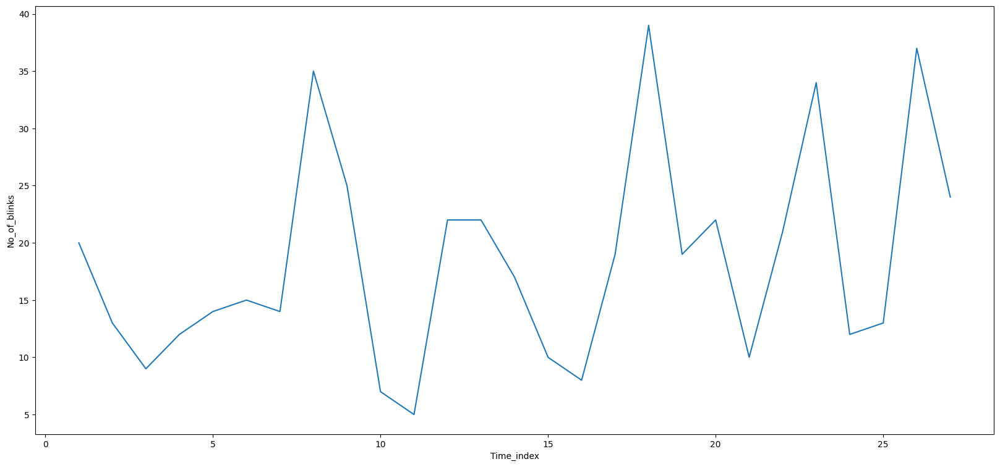

In [87]:
sns.lineplot(data=number_of_blinks_df, x="Time_index", y="No_of_blinks")

In [88]:
number_of_blinks_df.describe()

,Time_index,No_of_blinks
count,27.000000,27.000000
mean,14.000000,18.444444
std,7.937254,9.308116
min,1.000000,5.000000
25%,7.500000,12.000000
50%,14.000000,17.000000
75%,20.500000,22.000000
max,27.000000,39.000000


In [181]:
PERSON_ID = "Second_day"

number of blinks =  [44, 25, 42, 60, 29, 96, 78, 23, 33, 41, 110, 40, 58, 56, 36, 39, 92, 12, 100, 44, 43, 50, 13, 70, 58, 38, 13, 68, 26, 35, 11, 47, 97, 62, 13, 13, 58, 35, 33, 31, 32, 37, 34, 28, 22, 13, 8, 32, 31, 103, 12, 33, 75, 55, 89, 15, 4, 56, 33, 36, 75, 62, 37, 72, 9, 36, 24, 26, 28, 50, 31, 27, 36, 74, 116, 25, 33, 21, 25, 28, 43, 56, 81, 36, 36, 52, 71, 8, 11, 17, 57, 92, 88, 152, 80, 128, 59, 22, 113, 45, 29, 54, 53, 92, 28, 101, 44, 68, 57, 74, 60, 51, 23, 55, 47, 31]


<AxesSubplot:xlabel='FN', ylabel='EAR'>

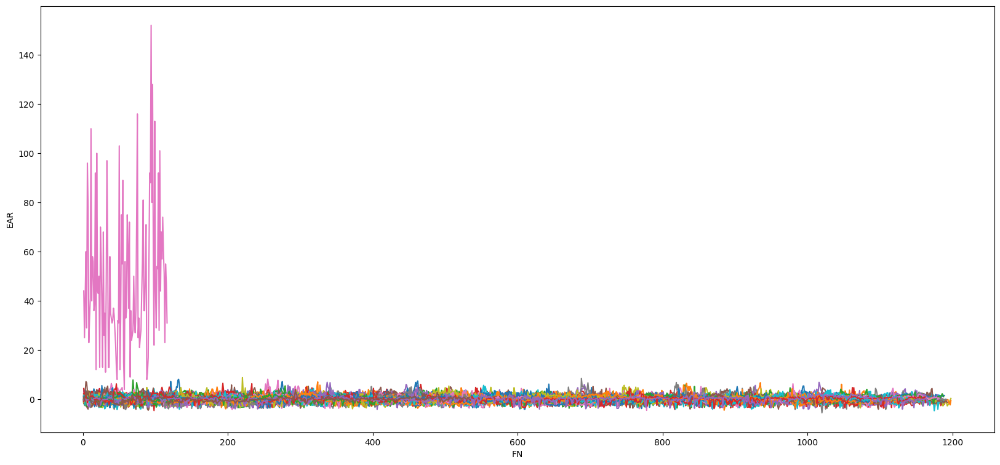

In [182]:
path = f"./{PERSON_ID}/"
csvfiles = []
number_of_blinks = []
EAR_dataframe = pd.DataFrame(columns=["File_Name","EAR_Min","EAR_Max","EAR_Mean", "EAR_SD"])
for x in os.listdir(path):
    if x.endswith(".csv"):
            csvfiles.append(x)
    #print(videofilename)
csvfiles.sort()
for x in csvfiles:
    df_alert = pd.read_csv(f"./{PERSON_ID}/{x}")
    if df_alert.empty:
        continue
    EAR_dataframe= EAR_dataframe.append({"File_Name":x,"EAR_Min":df_alert["EAR"].describe()[3],"EAR_Max":df_alert["EAR"].describe()[7],
                        "EAR_Mean":df_alert["EAR"].describe()[1], "EAR_SD":df_alert["EAR"].describe()[2]},ignore_index=True)
    mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
    df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
    df_alert["EMA"] = df_alert["EAR"].ewm(50).mean()
    df_alert["CMA"] = df_alert["EAR"].expanding().mean()
    df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
    df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]
    sns.lineplot(data= df_alert[["FN","EAR"]], x="FN",y="EAR")
    df_alert.dropna(inplace=True)
    result_alert_full = accumulate_Blinks(get_Binks(df_alert))
    num_blinks = len(result_alert_full)
    number_of_blinks.append(num_blinks)

    result_alert = [int(np.floor(np.mean(i))) for i in result_alert_full]

    p1_0_freq = get_Frequency(df_alert, result_alert)
    #duration_results_alert = []
    #for i in result_alert:
    #    duration_results_alert.append(get_Blink_Duration(i, df_alert))
    #P_INDEX_ALERT = get_PERCLOS(duration_results_alert)
    #P_INDEX_ALERT = calculate_PERCLOS(P_INDEX_ALERT)
    #print("Perclos index",P_INDEX_ALERT)
        

print("number of blinks = ", number_of_blinks)
time_index = list(range(1,len(number_of_blinks)+1))
number_of_blinks_df = pd.DataFrame(list(zip(time_index,number_of_blinks)),columns=["Time_index","No_of_blinks"])
sns.lineplot(data=number_of_blinks_df, x="Time_index", y="No_of_blinks")

In [106]:
number_of_blinks_df.describe()

,Time_index,No_of_blinks
count,116.000000,116.000000
mean,58.500000,48.008621
std,33.630343,28.946576
min,1.000000,4.000000
25%,29.750000,28.000000
50%,58.500000,40.500000
75%,87.250000,60.500000
max,116.000000,152.000000


<AxesSubplot:ylabel='EAR_Mean'>

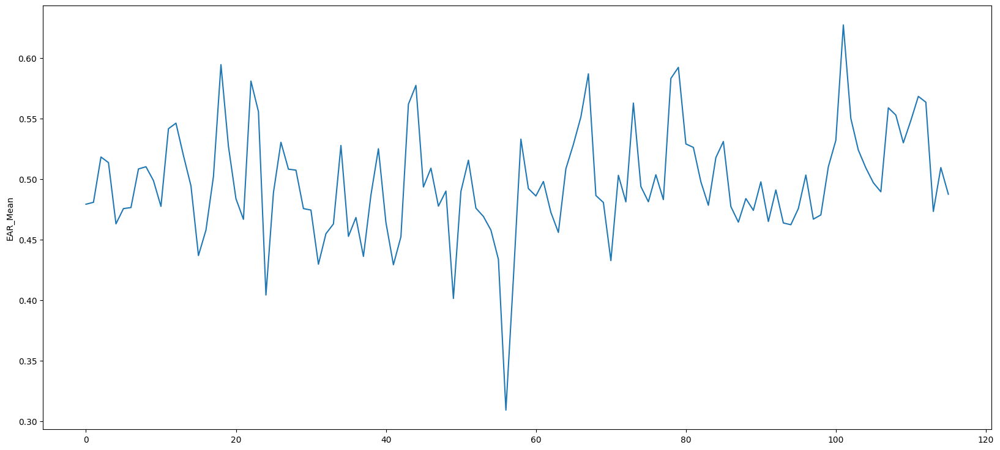

In [109]:
#EAR data
sns.lineplot(data=number_of_blinks_df, x=list(range(0,116)), y=EAR_dataframe["EAR_Mean"])

In [148]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go


fig = make_subplots(rows=1, cols=1)


fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
    row=1, col=1
)

fig.update_layout(height=450, width=1550, title_text="EAR with EMA")
fig.show()

In [49]:
fig = make_subplots(rows=1, cols=1)


fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["MOEAR"],  name = "MOEAR", mode = "lines"),
    row=1, col=1
)

fig.update_layout(height=450, width=1550, title_text="MOEAR with EMA")
fig.show()

### Here

In [327]:
df_alert = pd.read_csv(f"./rcam/rcam_220903_133354_EAR.csv")
mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
#df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
df_alert["EMA"] = df_alert["EAR"].ewm(60).mean()
#df_alert["CMA"] = df_alert["EAR"].expanding().mean()
#df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]
num_blinks = []
    #threshold = (max(df["EMA"]) + min(df["EAR"])) / 2
    #print("Threash hold: ",threshold)
threshold = df_alert["EMA"].mean()
counter = num_of_blinks= 0
for i in range(df_alert.shape[0]):
        #if (df["EAR"].iloc(i)) < (threshold):
    if (df_alert["EAR"].iloc[i]) < (threshold):
        num_blinks.append(i)
        counter += 1 
    else:
        if counter >= 6:
            num_of_blinks += 1
#df_alert.dropna(inplace=True)
        counter = 0
print("Number of blinks",num_of_blinks)


# EAR graph
fig = make_subplots(rows=1, cols=1)


fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
        row=1, col=1
    )    
fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
        row=1, col=1
    )
fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
        row=1, col=1
    )

fig.update_layout(height=450, width=1550, title_text="File Name: "+x+"    EAR with EMA:"+str(counter))
fig.show()



Number of blinks 23


In [326]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go


fig = make_subplots(rows=1, cols=1)


fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
    row=1, col=1
)

fig.update_layout(height=450, width=1550, title_text="EAR with EMA")
fig.show()

In [257]:
result_alert_full = accumulate_Blinks(get_Binks(df_alert))
num_blinks = len(result_alert_full)
print(f"Total number of blinks detected are = {num_blinks}.")

result_alert = [int(np.floor(np.mean(i))) for i in result_alert_full]

p1_0_freq = get_Frequency(df_alert, result_alert)

print(p1_0_freq)

blink_result = []
for i in range()
if df_alert["EAR"]




Total number of blinks detected are = 20.
{1: 20}


In [258]:
duration_results_alert = []
for i in result_alert:
    duration_results_alert.append(get_Blink_Duration(i, df_alert))
duration_results_alert

[(0.019, 56, 57, 60),
 (0.0, 61, 61, 71),
 (0.076, 61, 65, 71),
 (0.055, 107, 110, 115),
 (0.034, 136, 138, 143),
 (0.017, 153, 154, 158),
 (0.019, 214, 215, 219),
 (0.32, 219, 234, 244),
 (0.019, 258, 259, 264),
 (0.043, 311, 313, 317),
 (0.039, 337, 339, 343),
 (0.034, 397, 399, 405),
 (0.037, 414, 416, 424),
 (0.036, 496, 498, 503),
 (0.037, 511, 513, 519),
 (0.064, 826, 829, 835),
 (0.063, 844, 847, 852),
 (0.034, 865, 867, 872),
 (0.018, 898, 899, 910),
 (0.033, 1165, 1167, 1171)]

In [259]:
# velocity
velocity_alert = []
for i in duration_results_alert:
    velocity_alert.append(get_Blink_Velocity(i[0], i[1], i[2], df_alert))

In [260]:
P_INDEX_ALERT = get_PERCLOS(duration_results_alert)
P_INDEX_ALERT = calculate_PERCLOS(P_INDEX_ALERT)
P_INDEX_ALERT

[6.666666666666667,
 30.0,
 8.333333333333332,
 41.66666666666667,
 0.0,
 10.0,
 16.666666666666664,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0]

In [261]:
start, end = 0, 1

duration_alert = [i[0] for i in duration_results_alert]
velocity_alert = pd.DataFrame(velocity_alert)
velocity_alert.dropna(inplace=True)

# print(len(result_alert))
# print(len(result_sdrowsy))
# print(len(result_sleepy))
print(f"Blink Frequency = {p1_0_freq}")
print(f"Duration = {np.mean(duration_alert[:p1_0_freq[end]])}s")
print(f"Velocity = {np.mean(velocity_alert[0].iloc[:p1_0_freq[end]])}")
print(f"MEAN PERCLOS INDEX (ALERT) = {np.mean(P_INDEX_ALERT[:len(P_INDEX_ALERT)])}")

Blink Frequency = {1: 20}
Duration = 0.04985s
Velocity = 24.120875418903136
MEAN PERCLOS INDEX (ALERT) = 8.717948717948717


In [251]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(duration_alert))), y = duration_alert,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=850, width=1550, title_text="Blink Duration")
fig.show()

In [252]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(velocity_alert.shape[0])), y = velocity_alert[0],  name = "Alert"),
    row=1, col=1
)

fig.update_layout(height=800, width=1550, title_text="Velocity of Blinks")
fig.show()

In [262]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(P_INDEX_ALERT))), y = P_INDEX_ALERT,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=800, width=1550, title_text="PERCLOS INDEX of all the states")
fig.show()

# Second File

In [263]:
df_alert = pd.read_csv(f"./rcam/rcam_11_EAR.csv")
mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
df_alert["EMA"] = df_alert["EAR"].ewm(50).mean()
df_alert["CMA"] = df_alert["EAR"].expanding().mean()
df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]

df_alert.dropna(inplace=True)

In [264]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go


fig = make_subplots(rows=1, cols=1)


fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
    row=1, col=1
)

fig.update_layout(height=450, width=1550, title_text="EAR with EMA")
fig.show()

In [265]:
result_alert_full = accumulate_Blinks(get_Binks(df_alert))
num_blinks = len(result_alert_full)
print(f"Total number of blinks detected are = {num_blinks}.")

result_alert = [int(np.floor(np.mean(i))) for i in result_alert_full]

p1_0_freq = get_Frequency(df_alert, result_alert)

print(p1_0_freq)

Total number of blinks detected are = 13.
{1: 13}


In [266]:
duration_results_alert = []
for i in result_alert:
    duration_results_alert.append(get_Blink_Duration(i, df_alert))
duration_results_alert

[(0.039, 299, 301, 307),
 (0.036, 439, 441, 446),
 (0.063, 453, 456, 462),
 (0.035, 623, 625, 630),
 (0.063, 640, 643, 649),
 (-0.022, 876, 875, 876),
 (0.02, 930, 931, 934),
 (0.0, 934, 934, 936),
 (0.0, 954, 954, 957),
 (-0.017, 987, 986, 987),
 (0.021, 1076, 1077, 1082),
 (0.023, 1093, 1094, 1108),
 (0.0, 1109, 1109, 1111)]

In [267]:
# velocity
velocity_alert = []
for i in duration_results_alert:
    velocity_alert.append(get_Blink_Velocity(i[0], i[1], i[2], df_alert))

In [268]:
P_INDEX_ALERT = get_PERCLOS(duration_results_alert)
P_INDEX_ALERT = calculate_PERCLOS(P_INDEX_ALERT)
P_INDEX_ALERT

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

In [269]:
start, end = 0, 1

duration_alert = [i[0] for i in duration_results_alert]
velocity_alert = pd.DataFrame(velocity_alert)
velocity_alert.dropna(inplace=True)

# print(len(result_alert))
# print(len(result_sdrowsy))
# print(len(result_sleepy))
print(f"Blink Frequency = {p1_0_freq}")
print(f"Duration = {np.mean(duration_alert[:p1_0_freq[end]])}s")
print(f"Velocity = {np.mean(velocity_alert[0].iloc[:p1_0_freq[end]])}")
print(f"MEAN PERCLOS INDEX (ALERT) = {np.mean(P_INDEX_ALERT[:len(P_INDEX_ALERT)])}")

Blink Frequency = {1: 13}
Duration = 0.020076923076923072s
Velocity = 25.990660447571134
MEAN PERCLOS INDEX (ALERT) = 0.0


In [270]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(duration_alert))), y = duration_alert,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=850, width=1550, title_text="Blink Duration")
fig.show()

In [271]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(velocity_alert.shape[0])), y = velocity_alert[0],  name = "Alert"),
    row=1, col=1
)

fig.update_layout(height=800, width=1550, title_text="Velocity of Blinks")
fig.show()

In [272]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(P_INDEX_ALERT))), y = P_INDEX_ALERT,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=800, width=1550, title_text="PERCLOS INDEX of all the states")
fig.show()

In [273]:
df_alert = pd.read_csv(f"./rcam/rcam_220903_133354_EAR.csv")
mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
df_alert["EMA"] = df_alert["EAR"].ewm(50).mean()
df_alert["CMA"] = df_alert["EAR"].expanding().mean()
df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]

df_alert.dropna(inplace=True)

In [274]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go


fig = make_subplots(rows=1, cols=1)


fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
    row=1, col=1
)

fig.update_layout(height=450, width=1550, title_text="EAR with EMA")
fig.show()

In [275]:
result_alert_full = accumulate_Blinks(get_Binks(df_alert))
num_blinks = len(result_alert_full)
print(f"Total number of blinks detected are = {num_blinks}.")

result_alert = [int(np.floor(np.mean(i))) for i in result_alert_full]

p1_0_freq = get_Frequency(df_alert, result_alert)

print(p1_0_freq)

Total number of blinks detected are = 37.
{1: 37}


In [276]:
duration_results_alert = []
for i in result_alert:
    duration_results_alert.append(get_Blink_Duration(i, df_alert))
duration_results_alert

[(0.0, 8, 8, 21),
 (-0.024, 27, 26, 27),
 (-0.018, 30, 29, 30),
 (0.0, 34, 34, 36),
 (0.0, 72, 72, 77),
 (0.163, 77, 86, 111),
 (0.22, 77, 89, 111),
 (0.256, 77, 91, 111),
 (0.302, 77, 94, 111),
 (0.431, 77, 100, 111),
 (0.514, 77, 102, 111),
 (0.591, 77, 105, 111),
 (0.152, 197, 205, 208),
 (0.033, 243, 245, 248),
 (0.05, 283, 285, 290),
 (0.06, 320, 323, 328),
 (0.054, 340, 343, 348),
 (0.0, 371, 371, 376),
 (0.0, 382, 382, 387),
 (0.032, 382, 384, 387),
 (0.016, 427, 428, 431),
 (0.019, 441, 442, 445),
 (0.031, 490, 492, 497),
 (0.0, 506, 506, 512),
 (0.052, 506, 509, 512),
 (0.0, 691, 691, 693),
 (0.067, 916, 920, 926),
 (0.032, 936, 938, 944),
 (0.059, 975, 978, 983),
 (0.018, 998, 999, 1004),
 (0.033, 1025, 1027, 1032),
 (0.131, 1074, 1082, 1084),
 (0.05, 1130, 1133, 1137),
 (0.081, 1130, 1135, 1137),
 (-0.018, 1145, 1144, 1145),
 (-0.018, 1147, 1146, 1147),
 (0.047, 1178, 1181, 1186)]

In [277]:
# velocity
velocity_alert = []
for i in duration_results_alert:
    velocity_alert.append(get_Blink_Velocity(i[0], i[1], i[2], df_alert))

In [278]:
P_INDEX_ALERT = get_PERCLOS(duration_results_alert)
P_INDEX_ALERT = calculate_PERCLOS(P_INDEX_ALERT)
P_INDEX_ALERT

[25.0,
 396.6666666666667,
 0.0,
 0.0,
 0.0,
 13.333333333333334,
 16.666666666666664,
 6.666666666666667,
 20.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0]

In [279]:
start, end = 0, 1

duration_alert = [i[0] for i in duration_results_alert]
velocity_alert = pd.DataFrame(velocity_alert)
velocity_alert.dropna(inplace=True)

# print(len(result_alert))
# print(len(result_sdrowsy))
# print(len(result_sleepy))
print(f"Blink Frequency = {p1_0_freq}")
print(f"Duration = {np.mean(duration_alert[:p1_0_freq[end]])}s")
print(f"Velocity = {np.mean(velocity_alert[0].iloc[:p1_0_freq[end]])}")
print(f"MEAN PERCLOS INDEX (ALERT) = {np.mean(P_INDEX_ALERT[:len(P_INDEX_ALERT)])}")

Blink Frequency = {1: 37}
Duration = 0.09232432432432433s
Velocity = 12.450708161700723
MEAN PERCLOS INDEX (ALERT) = 25.17543859649123


In [280]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(duration_alert))), y = duration_alert,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=850, width=1550, title_text="Blink Duration")
fig.show()

In [281]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(velocity_alert.shape[0])), y = velocity_alert[0],  name = "Alert"),
    row=1, col=1
)

fig.update_layout(height=800, width=1550, title_text="Velocity of Blinks")
fig.show()

In [283]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(P_INDEX_ALERT))), y = P_INDEX_ALERT,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=800, width=1550, title_text="PERCLOS INDEX of all the states")
fig.show()

In [284]:
df_alert = pd.read_csv(f"./rcam/rcam_220903_132108_EAR.csv")
mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
df_alert["EMA"] = df_alert["EAR"].ewm(50).mean()
df_alert["CMA"] = df_alert["EAR"].expanding().mean()
df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]

df_alert.dropna(inplace=True)

In [285]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go


fig = make_subplots(rows=1, cols=1)


fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
    row=1, col=1
)
fig.append_trace(
    go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
    row=1, col=1
)

fig.update_layout(height=450, width=1550, title_text="EAR with EMA")
fig.show()

In [286]:
result_alert_full = accumulate_Blinks(get_Binks(df_alert))
num_blinks = len(result_alert_full)
print(f"Total number of blinks detected are = {num_blinks}.")

result_alert = [int(np.floor(np.mean(i))) for i in result_alert_full]

p1_0_freq = get_Frequency(df_alert, result_alert)

print(p1_0_freq)

Total number of blinks detected are = 14.
{1: 14}


In [287]:
duration_results_alert = []
for i in result_alert:
    duration_results_alert.append(get_Blink_Duration(i, df_alert))
duration_results_alert

[(0.071, 115, 119, 125),
 (0.032, 382, 384, 389),
 (0.09, 402, 407, 414),
 (0.051, 437, 440, 445),
 (0.452, 705, 729, 733),
 (0.059, 754, 757, 763),
 (0.05, 772, 775, 781),
 (0.052, 811, 814, 819),
 (0.05, 829, 832, 837),
 (-0.015, 1044, 1043, 1044),
 (0.0, 1058, 1058, 1060),
 (0.0, 1068, 1068, 1070),
 (0.087, 1076, 1081, 1090),
 (0.067, 1122, 1126, 1131)]

In [288]:
# velocity
velocity_alert = []
for i in duration_results_alert:
    velocity_alert.append(get_Blink_Velocity(i[0], i[1], i[2], df_alert))

In [289]:
P_INDEX_ALERT = get_PERCLOS(duration_results_alert)
P_INDEX_ALERT = calculate_PERCLOS(P_INDEX_ALERT)
P_INDEX_ALERT

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

In [290]:
start, end = 0, 1

duration_alert = [i[0] for i in duration_results_alert]
velocity_alert = pd.DataFrame(velocity_alert)
velocity_alert.dropna(inplace=True)

# print(len(result_alert))
# print(len(result_sdrowsy))
# print(len(result_sleepy))
print(f"Blink Frequency = {p1_0_freq}")
print(f"Duration = {np.mean(duration_alert[:p1_0_freq[end]])}s")
print(f"Velocity = {np.mean(velocity_alert[0].iloc[:p1_0_freq[end]])}")
print(f"MEAN PERCLOS INDEX (ALERT) = {np.mean(P_INDEX_ALERT[:len(P_INDEX_ALERT)])}")

Blink Frequency = {1: 14}
Duration = 0.07471428571428572s
Velocity = 18.619818522487133
MEAN PERCLOS INDEX (ALERT) = 0.0


In [291]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(duration_alert))), y = duration_alert,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=850, width=1550, title_text="Blink Duration")
fig.show()

In [292]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(velocity_alert.shape[0])), y = velocity_alert[0],  name = "Alert"),
    row=1, col=1
)

fig.update_layout(height=800, width=1550, title_text="Velocity of Blinks")
fig.show()

In [293]:
fig = make_subplots(rows=1, cols=1, subplot_titles=("Alert"))


fig.append_trace(
    go.Bar(x = list(range(len(P_INDEX_ALERT))), y = P_INDEX_ALERT,  name = "Alert"),
    row=1, col=1
)


fig.update_layout(height=800, width=1550, title_text="PERCLOS INDEX of all the states")
fig.show()

In [342]:
path = f"./trip3_omsCam_2/"
csvfiles = []
number_of_blinks = []
for x in os.listdir(path):
    if x.endswith(".csv"):
            csvfiles.append(x)
    #print(videofilename)
csvfiles.sort()
counter = 1
perclos_value=list()
for x in csvfiles:
    df_alert = pd.read_csv(f"./trip3_omsCam_2/{x}")
    if df_alert.empty:
        continue
    mean, std_dev = df_alert["EAR"].describe()[1], df_alert["EAR"].describe()[2]
    #df_alert["EAR"] = df_alert["EAR"].apply(lambda x: (x - mean)/std_dev)
    df_alert["EMA"] = df_alert["EAR"].ewm(40).mean()
    #df_alert["CMA"] = df_alert["EAR"].expanding().mean()
    #df_alert["SMA"] = df_alert["EAR"].rolling(50, min_periods=1).mean()
    df_alert["EMA_MEAN"] = [df_alert["EMA"].mean()] * df_alert.shape[0]
    num_blinks = []
    #threshold = (max(df["EMA"]) + min(df["EAR"])) / 2
    #print("Threash hold: ",threshold)
    threshold = df_alert["EMA"].mean()
    counter = num_of_blinks= 0
    for i in range(df_alert.shape[0]):
        #if (df["EAR"].iloc(i)) < (threshold):
        if (df_alert["EAR"].iloc[i]) < (threshold):
            num_blinks.append(i)
            counter += 1 
        else:
            if counter >= 6:
                num_of_blinks += 1
    #df_alert.dropna(inplace=True)
            counter = 0
    number_of_blinks.append(num_of_blinks)
    #print("Number of blinks",num_of_blinks)

    #plt.figure()
    #sns.lineplot(data= df_alert[["FN","EAR"]], x="FN",y="EAR")

    fig = make_subplots(rows=1, cols=1)


    fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = df_alert["EAR"],  name = "EAR", mode = "lines"),
        row=1, col=1
    )
    fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = df_alert["EMA"],  name = "EMA", mode = "lines"),
        row=1, col=1
    )
    fig.append_trace(
        go.Scatter(x = df_alert["FN"], y = [np.mean(df_alert["EMA"])] * df_alert.shape[0],  name = "EMA_MEAN", mode = "lines"),
        row=1, col=1
    )
    fig.update_layout(height=450, width=1550, title_text="EAR with EMA: "+ x + "Number of blinks: "+ str(num_of_blinks))
    fig.show()

print(number_of_blinks)

[30, 23, 27, 34, 21, 22, 30, 30, 32, 27, 32, 22, 27, 27, 28, 26, 28, 30, 27, 29, 26, 38, 35, 31, 32, 19, 27, 32, 33, 29, 16, 31, 19, 31, 23, 24, 33, 28, 28, 12, 24, 31, 33, 31, 29, 32, 33, 13, 28, 31, 13, 33, 25, 23, 29, 21, 26, 27, 31, 19, 14, 20, 18, 19, 19, 20, 19, 24, 36, 17, 17, 19, 27, 14, 15, 18, 16, 25, 24, 16, 24, 20, 14, 24, 11, 19, 20, 27, 22, 29, 27, 26, 26, 15, 23, 19, 26, 27, 22, 28, 28, 21, 23, 33, 34, 30, 23, 25, 25, 32, 25, 24, 30, 16, 25, 36, 28, 26, 20, 25, 22, 35, 33, 22, 28, 30]


[30, 23, 27, 34, 21, 22, 30, 30, 32, 27, 32, 22, 27, 27, 28, 26, 28, 30, 27, 29, 26, 38, 35, 31, 32, 19, 27, 32, 33, 29, 16, 31, 19, 31, 23, 24, 33, 28, 28, 12, 24, 31, 33, 31, 29, 32, 33, 13, 28, 31, 13, 33, 25, 23, 29, 21, 26, 27, 31, 19, 14, 20, 18, 19, 19, 20, 19, 24, 36, 17, 17, 19, 27, 14, 15, 18, 16, 25, 24, 16, 24, 20, 14, 24, 11, 19, 20, 27, 22, 29, 27, 26, 26, 15, 23, 19, 26, 27, 22, 28, 28, 21, 23, 33, 34, 30, 23, 25, 25, 32, 25, 24, 30, 16, 25, 36, 28, 26, 20, 25, 22, 35, 33, 22, 28, 30]


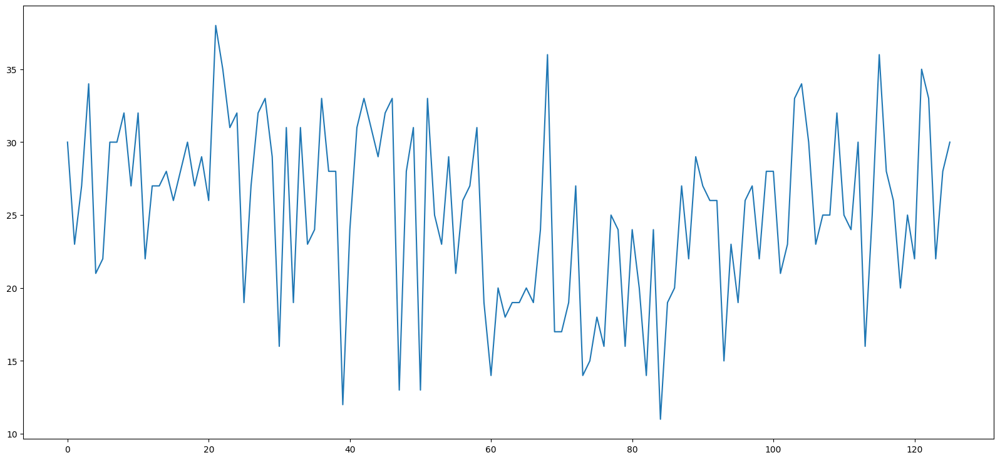

In [340]:
sns.lineplot(data=number_of_blinks,markers=True,estimator='mean')
print(number_of_blinks)

In [335]:
print(sum(number_of_blinks)/len(number_of_blinks))

25.206349206349206
